In [259]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import initializers
from keras.layers import Dense, Dropout, Input
from keras.models import Model,Sequential
from keras.preprocessing.image import ImageDataGenerator
from tqdm import tqdm
from keras.optimizers import Adam


In [260]:
image_size = (128, 128)

# https://www.kaggle.com/code/jiaowoguanren/animal-classification-tensorflow 
image_generator = ImageDataGenerator(rescale = 1. / 255).flow_from_directory(
    './animals',
    target_size=image_size,
    batch_size=1,
    class_mode='binary'
)

image_generator.reset()

x = []
y = []

for i in range(image_generator.__len__()):
	image_x, image_y = image_generator.next()
	
	x.append(image_x[0])
	y.append(image_y[0])

x = np.asarray(x, dtype=np.float32)
y = np.asarray(y, dtype=np.float32)


Found 4000 images belonging to 4 classes.


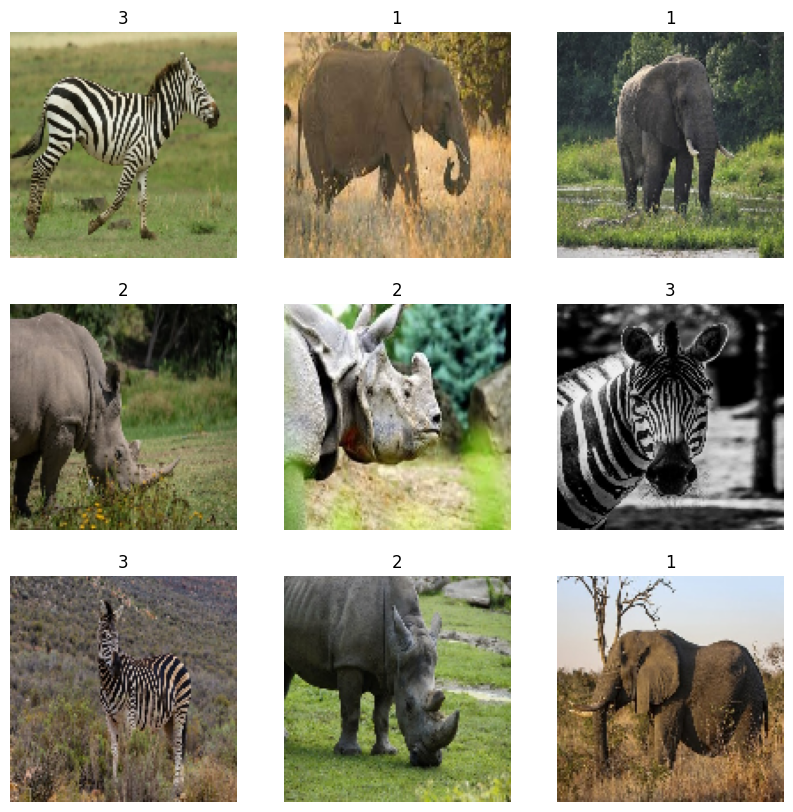

In [261]:
image_generator.reset()

plt.figure(figsize=(10, 10))
for i in range(9):
	image, label = image_generator.next()
	ax = plt.subplot(3, 3, i + 1)
	plt.imshow(image[0])
	plt.title(int(label[0]))
	plt.axis("off")


In [262]:
x.shape


(4000, 128, 128, 3)

In [263]:
num_classes = 4
output_dimension = image_size[0] * image_size[1]
latent_dim = 100


In [264]:
discriminator = keras.Sequential([
	layers.Conv2D(32, (5,5), input_shape=image_size + (3,), padding='same', kernel_initializer=initializers.RandomNormal(stddev=0.02)),
	layers.LeakyReLU(alpha=0.2),
	layers.Conv2D(64, (5,5), strides=(2,2), padding='same'),
	layers.LeakyReLU(alpha=0.2),
	layers.Conv2D(128, (5,5), strides=(2,2), padding='same'),
	layers.LeakyReLU(alpha=0.2),
	layers.Conv2D(128, (5,5), strides=(2,2), padding='same'),
	layers.LeakyReLU(alpha=0.2),
	layers.Flatten(),
	layers.Dense(1, activation='sigmoid')
])

discriminator.summary()

discriminator.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5), metrics=['accuracy'])


Model: "sequential_52"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_25 (Conv2D)          (None, 128, 128, 32)      2432      
                                                                 
 leaky_re_lu_190 (LeakyReLU)  (None, 128, 128, 32)     0         
                                                                 
 conv2d_26 (Conv2D)          (None, 64, 64, 64)        51264     
                                                                 
 leaky_re_lu_191 (LeakyReLU)  (None, 64, 64, 64)       0         
                                                                 
 conv2d_27 (Conv2D)          (None, 32, 32, 128)       204928    
                                                                 
 leaky_re_lu_192 (LeakyReLU)  (None, 32, 32, 128)      0         
                                                                 
 conv2d_28 (Conv2D)          (None, 16, 16, 128)     

In [265]:
f_1 = 4

generator = keras.Sequential([
	layers.Dense(f_1 * f_1 * 256, input_dim=latent_dim),
	layers.Reshape((f_1, f_1, 256)),
	layers.LeakyReLU(alpha=0.2),
	layers.Conv2DTranspose(128, (3, 3), strides=(2,2), padding='same'),
	layers.BatchNormalization(),
	layers.LeakyReLU(alpha=0.2),
	layers.Conv2DTranspose(128, (3, 3), strides=(2,2), padding='same'),
	layers.BatchNormalization(),
	layers.LeakyReLU(alpha=0.2),
	layers.Conv2DTranspose(64, (3, 3), strides=(2,2), padding='same'),
	layers.BatchNormalization(),
	layers.LeakyReLU(alpha=0.2),
	layers.Conv2DTranspose(64, (3, 3), strides=(2,2), padding='same'),
	layers.BatchNormalization(),
	layers.LeakyReLU(alpha=0.2),
	layers.Conv2DTranspose(3, (3, 3), strides=(2,2), padding='same', activation='tanh')
])

generator.summary()

generator.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5), metrics=['accuracy'])


Model: "sequential_53"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_131 (Dense)           (None, 4096)              413696    
                                                                 
 reshape_22 (Reshape)        (None, 4, 4, 256)         0         
                                                                 
 leaky_re_lu_194 (LeakyReLU)  (None, 4, 4, 256)        0         
                                                                 
 conv2d_transpose_87 (Conv2D  (None, 8, 8, 128)        295040    
 Transpose)                                                      
                                                                 
 batch_normalization_70 (Bat  (None, 8, 8, 128)        512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_195 (LeakyReLU)  (None, 8, 8, 128)      

In [266]:
discriminator.trainable = False

gan_input = keras.Input(shape=(latent_dim,))
temp = generator(gan_input)
gan_output = discriminator(temp)

gan = keras.Model(inputs=gan_input, outputs=gan_output)
gan.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5))


In [270]:
def plot_generated_images(epoch, generator):
	num_of_images = 10
	noise = np.random.normal(0, 1, size=[num_of_images, latent_dim])
	generated_images=(generator.predict(noise) + 1) / 2.0

	plt.figure(figsize=(20, 5))

	for i in range(num_of_images):
		plt.subplot(1, 10, i+1)
		plt.imshow(generated_images[i])
		plt.axis('off')
		plt.tight_layout()
	plt.show()


In [271]:
discrim_losses = []

def train_model(epochs, batch_size):
	num_batches = int(x.shape[0]/batch_size)
	for ep in range(epochs+1):
		for i in range(num_batches):
			noise = np.random.normal(0, 1, size=[batch_size, latent_dim])
			image_batch = x[np.random.randint(0, x.shape[0], size=batch_size)]

			generated_images = generator.predict(noise, verbose=0)

			X = np.concatenate([image_batch, generated_images])

			y_dis = np.zeros(2*batch_size)
			y_dis[:batch_size] = 0.9
			discriminator.trainable = True
			d_loss = discriminator.train_on_batch(X, y_dis)
			discrim_losses.append(d_loss)

			noise = np.random.normal(0, 1, size=[batch_size, latent_dim])
			y_gen = np.ones(batch_size)
			discriminator.trainable = False
			gan.train_on_batch(noise, y_gen)
		print('epoch: ', ep)
		plot_generated_images(ep, generator)


epoch:  0
1/1 [==============================] - 0s 23ms/step


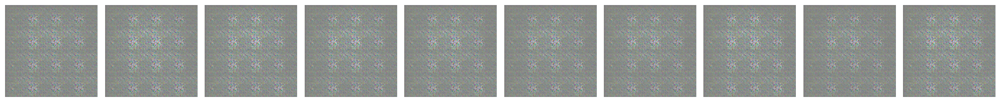

epoch:  1
1/1 [==============================] - 0s 23ms/step


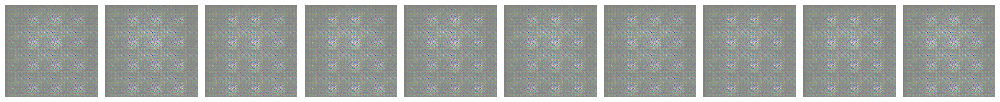

epoch:  2
1/1 [==============================] - 0s 25ms/step


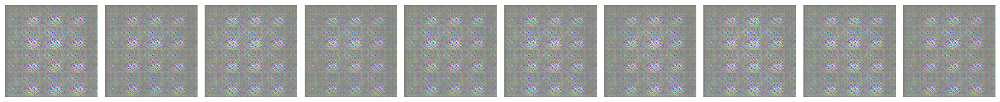

epoch:  3
1/1 [==============================] - 0s 22ms/step


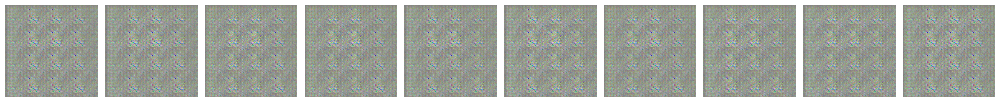

epoch:  4
1/1 [==============================] - 0s 25ms/step


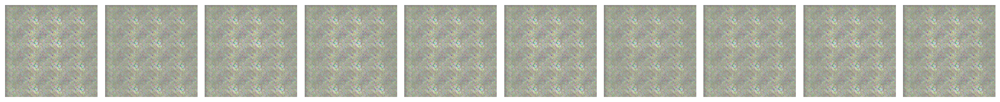

epoch:  5
1/1 [==============================] - 0s 35ms/step


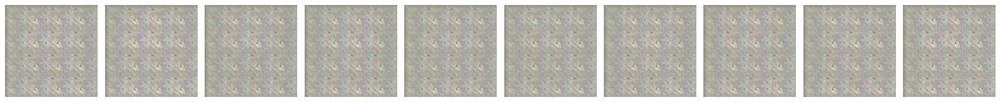

epoch:  6
1/1 [==============================] - 0s 22ms/step


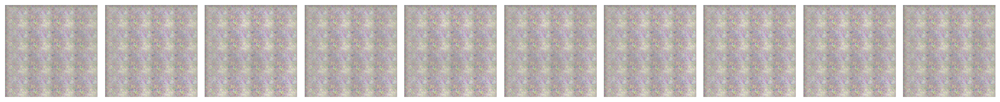

epoch:  7
1/1 [==============================] - 0s 28ms/step


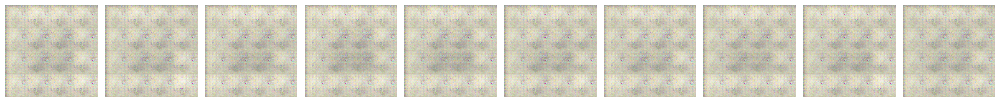

epoch:  8
1/1 [==============================] - 0s 26ms/step


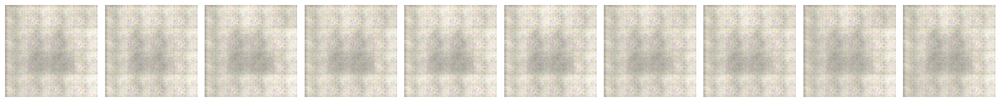

epoch:  9
1/1 [==============================] - 0s 26ms/step


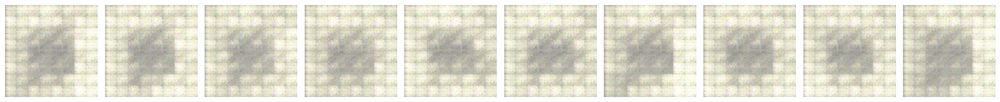

epoch:  10
1/1 [==============================] - 0s 27ms/step


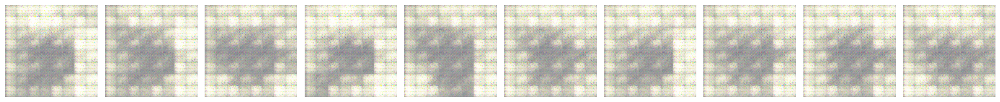

epoch:  11
1/1 [==============================] - 0s 23ms/step


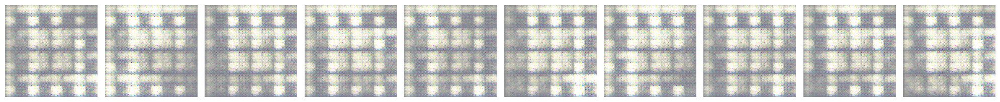

epoch:  12
1/1 [==============================] - 0s 23ms/step


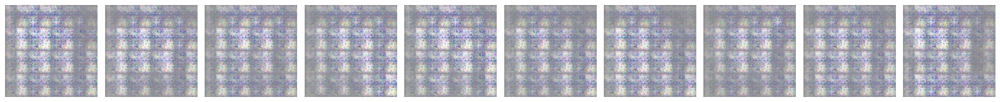

epoch:  13
1/1 [==============================] - 0s 24ms/step


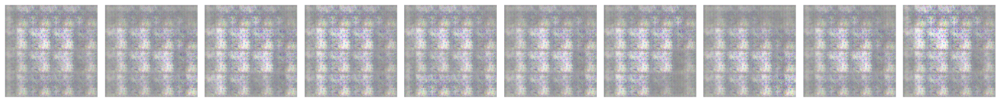

epoch:  14
1/1 [==============================] - 0s 26ms/step


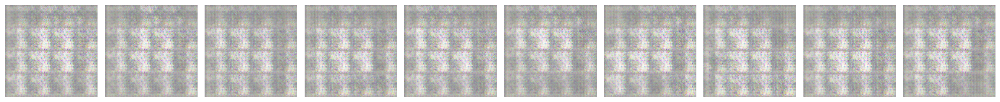

epoch:  15
1/1 [==============================] - 0s 24ms/step


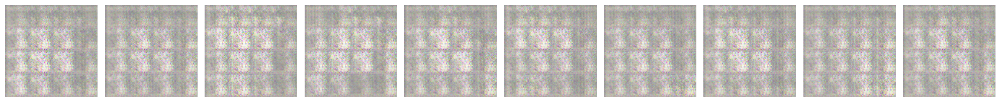

epoch:  16
1/1 [==============================] - 0s 24ms/step


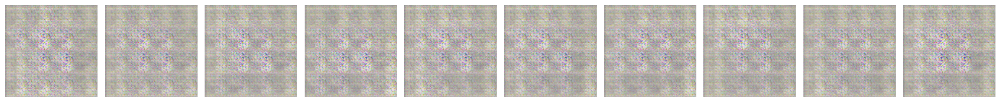

epoch:  17
1/1 [==============================] - 0s 24ms/step


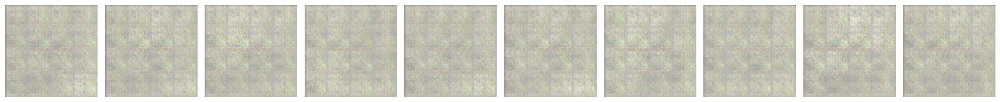

epoch:  18
1/1 [==============================] - 0s 24ms/step


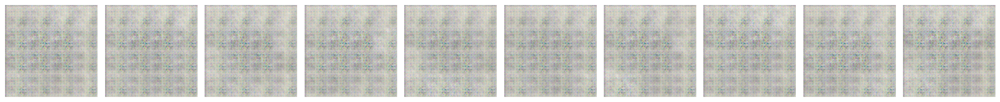

epoch:  19
1/1 [==============================] - 0s 24ms/step


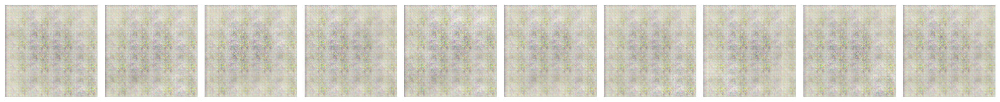

epoch:  20
1/1 [==============================] - 0s 28ms/step


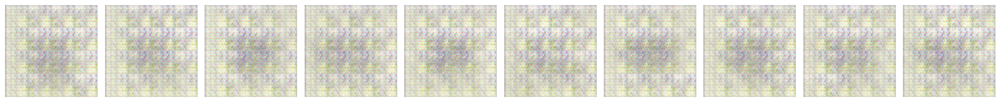

In [272]:
epochs = 20
batch_size = 128
train_model(epochs, batch_size)